(https://www.kaggle.com/c/ashrae-energy-prediction/)

# ASHRAE - Great Energy Predictor III
### How much energy will a building consume?

Data Description
Assessing the value of energy efficiency improvements can be challenging as 
there's no way to truly know how much energy a building would have used without the improvements. 
The best we can do is to build counterfactual models. Once a building is overhauled the new (lower) energy consumption is compared against modeled values 
for the original building to calculate the savings from the retrofit. More accurate models could support better market incentives and enable lower cost financing.

This competition challenges you to build these counterfactual models across four energy types based on historic usage rates and observed weather. 
The dataset includes three years of hourly meter readings from over one thousand buildings at several different sites around the world.

## Data Description

Files

- train.csv
    --building_id - Foreign key for the building metadata.
     --meter - The meter id code. Read as {0: electricity, 1: chilledwater, 2: steam, 3: hotwater}. Not every building has all meter types.
     --timestamp - When the measurement was taken
     --meter_reading - The target variable. Energy consumption in kWh (or equivalent). Note that this is real data with measurement error, which we expect will impose a baseline level of modeling error. UPDATE: as discussed here, the site 0 electric meter readings are in   kBTU.

building_meta.csv
    -  site_id - Foreign key for the weather files.
    -  building_id - Foreign key for training.csv
    -  primary_use - Indicator of the primary category of activities for the building based on EnergyStar property type definitions
    -  square_feet - Gross floor area of the building
    -  year_built - Year building was opened
    -  floor_count - Number of floors of the building

weather_[train/test].csv - Weather data from a meteorological station as close as possible to the site.

    - site_id
    - air_temperature - Degrees Celsius
    - cloud_coverage - Portion of the sky covered in clouds, in oktas
    - dew_temperature - Degrees Celsius
    - precip_depth_1_hr - Millimeters
    - sea_level_pressure - Millibar/hectopascals
    - wind_direction - Compass direction (0-360)
    - wind_speed - Meters per second
    - test.csv

The submission files use row numbers for ID codes in order to save space on the file uploads. test.csv has no feature data; it exists so you can get your predictions into the correct order.
    - row_id - Row id for your submission file
    - building_id - Building id code
    - meter - The meter id code
    - timestamp - Timestamps for the test data period

sample_submission.csv
A valid sample submission.

All floats in the solution file were truncated to four decimal places; we recommend you do the same to save space on your file upload.
There are gaps in some of the meter readings for both the train and test sets. Gaps in the test set are not revealed or scored.


In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import plotly as plt
import plotly.express as px
import statsmodels as st

import pandas_profiling as ppf
import sweetviz as sv
import missingno as msno

from matplotlib import pyplot

import pprint
import datetime

from plotly.subplots import make_subplots
import plotly.graph_objects as go

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import scale

sns.set(rc={'figure.figsize':(30,20)})

In [2]:
# Dictonary for easy lookup of transformed data

data_map = {'Weather Train':
                            { 'name':'Weather Train',
                              'desc':'''Weather data from a meteorological station as close as possible to the site.''',
                              'filepath':'.//data//weather_train.csv',
                              'date_cols':['timestamp'],
                              'viz_output_folder':'.//visualization//',
                              'df':None,
                            },
            'Weather Test':
                            { 'name':'Weather Test',
                              'desc':'''Weather data from a meteorological station as close as possible to the site.''',
                              'filepath':'.//data//weather_test.csv',
                              'date_cols':['timestamp'],
                              'viz_output_folder':'.//visualization//',
                              'df':None},
            'Train':
                            { 'name':'Train',
                              'desc':'Weather data from a meteorological station as close as possible to the site.',
                              'filepath':'.//data//train.csv',
                              'date_cols':['timestamp'],
                              'viz_output_folder':'.//visualization//',
                              'df':None,
                              'df_splits':None},
            'Test':
                            { 'name':'Test',
                              'desc':'The submission files use row numbers for ID codes in order to save space on the file uploads. test.csv has no feature data; it exists so you can get your predictions into the correct order.',
                              'notes':'1500 building_ids',
                              'date_cols':['timestamp'],
                              'viz_output_folder':'.//visualization//',
                              'filepath':'.//data//test.csv',
                              'df':None,
                              'df_splits':None},
            'Sample Submission':
                            { 'name':'Sample_Submission',
                              'desc':'A valid sample submission',
                              'date_cols':[],
                              'viz_output_folder':'.//visualization//',
                              'filepath':'.//data//sample_submission.csv',
                              'df':None},
            'Building Metadata':
                            { 'name':'Building Metadata',
                              'desc':'''All building information''',
                              'filepath':'.//data//building_metadata.csv',
                              'date_cols':[],
                              'viz_output_folder':'.//visualization//',
                              'df':None},
                            }
        

In [3]:
# Build dataframes and stick them to data_map
def buildFrames(data_map):
    '''
    Populate Dataframes from Data Map
    '''
    for key,value in data_map.items():
        print('Building DataFrame for ' + key)
        # Did we specify date cols
        if data_map[key]['date_cols']:
            data_map[key]['df'] = pd.read_csv(value['filepath'],infer_datetime_format=True,parse_dates=data_map[key]['date_cols'])
        else: # Didn't specify, need to 
            data_map[key]['df'] = pd.read_csv(value['filepath'])
    return data_map

In [4]:
# Build pandas profiles
def buildProfiles(data_map):
    for key,value in data_map.items():
        print("")
        print('Generating Report for ' + value['name'])
        report = ppf.ProfileReport(data_map[key]['df'], title=value['name'],dark_mode=True,explorative=True)
        report_filename = value['viz_output_folder'] + value['name'] + "_profile.html"
        report.to_file(report_filename)

In [5]:
# Join weather and specific buildings together and stick to tree
def merge_weather_to_site(df_building, df_weather, df_meter, build_id):
    '''
    Merge the meter readings to the weather data on timestamp per building ID
    Output: Merged dataframe on timestamp
    '''
    # Find out which site_id is a building
    site_id = int(df_building[df_building['building_id'] == build_id]['site_id'].values[0])
    # Pull weather for that site ID
    sample_weather = df_weather[df_weather['site_id'] == site_id]
    # Pull building id
    sample_train = df_meter[df_meter['building_id'] == building_id]
    # Merge these two
    merge_df = pd.merge_ordered(sample_train,sample_weather, on='timestamp',how='inner')
    # Set index to timestamp
    merge_df.set_index('timestamp',inplace=True)
    return merge_df

In [6]:
# Convert energy units
def convert_kBTU_to_kWH(kBTU):
    return kBTU / 3.412

In [7]:
# Convert timestamp to season
def get_season(timestamp_series):
    return [month%12 // 3 + 1 for month in timestamp_series.dt.month]

## Sample Workflow

- Pick the building id from Building Metadata
- Find the owning site id (multiple building per site)
- Merge on timestamp
- Make timestamp the index
- Resample on single day, then recalc features (max for temperature, etc)


## Build DataFrames and Populate Dictionary

In [8]:
data_map = buildFrames(data_map)

Building DataFrame for Weather Train
Building DataFrame for Weather Test
Building DataFrame for Train
Building DataFrame for Test
Building DataFrame for Sample Submission
Building DataFrame for Building Metadata


# Weather Data

- Timestamps are not unique thus they cannot be index
- 139,773 entries
- site_id  - 16 sites (0-15)
- timestamp - 1 month of data, 1 hour increments, (2016)
- Weather train data is 1/2016 to 12/2016 in 1 hour increments
- Weather test data is 1/2017 to 12/2018 in 1 hour increments
- NEEDS RESAMPLING, WILL HAPPEN AFTER JOINING
-- Timestamp column is not unique (16 different site ids)


## Visualization - Time vs Weather

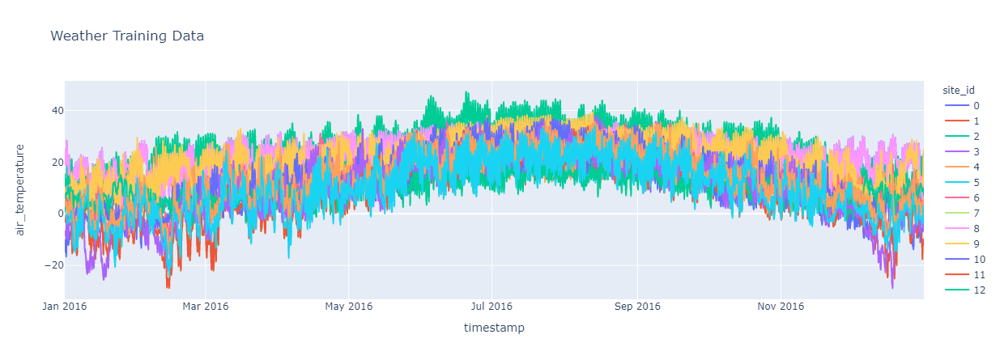

In [9]:
# Write to file and view
sample_df = data_map['Weather Train']['df']
fig = px.line(sample_df, x=sample_df['timestamp'], y="air_temperature", color="site_id", line_group="site_id",
        line_shape="spline", render_mode="svg",title='Weather Training Data')
#plt.offline.plot(fig, filename=data_map['Weather Train']['viz_output_folder'] +'//WeatherTrain_AllLine.html')
fig.write_image('.//images//'+ 'Weather Train Line All.png')
fig

## Add month columns

In [10]:
data_map['Weather Train']['df']['month'] = data_map['Weather Train']['df']['timestamp'].dt.month

In [11]:
data_map['Weather Train']['df']['timestamp'].max()

Timestamp('2016-12-31 23:00:00')

In [12]:
data_map['Weather Train']['df']['timestamp'].min()

Timestamp('2016-01-01 00:00:00')

## Visualization - Violin of Sites temperatures

In [13]:
sample_df = data_map['Weather Train']['df']
fig = px.violin(sample_df, y="air_temperature", x="site_id", color="month", box=True, points="all",title='Weather Train by Site')
plt.offline.plot(fig, filename=data_map['Weather Train']['viz_output_folder'] +'//WeatherTrain_violin_' + 'air_temperature' + '.html')

'.//visualization////WeatherTrain_violin_air_temperature.html'

## To Pickle

In [14]:
data_map['Weather Train']['df'].to_pickle('.//dataframes//Weather Train.pkl')

# Weather Test

Okta - 0-8 code determining cloud cover
https://en.wikipedia.org/wiki/Okta

In [15]:
data_map['Weather Test']['df'].head()

,site_id,timestamp,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed
0,0,2017-01-01 00:00:00,17.8,4.0,11.7,NaN,1021.4,100.0,3.6
1,0,2017-01-01 01:00:00,17.8,2.0,12.8,0.0,1022.0,130.0,3.1
2,0,2017-01-01 02:00:00,16.1,0.0,12.8,0.0,1021.9,140.0,3.1
3,0,2017-01-01 03:00:00,17.2,0.0,13.3,0.0,1022.2,140.0,3.1
4,0,2017-01-01 04:00:00,16.7,2.0,13.3,0.0,1022.3,130.0,2.6


## Visualization  Linegraphs of Weather Test Features

In [16]:
sample_df = data_map['Weather Test']['df']
graph_cols = ['air_temperature']
for col in graph_cols:
    fig = px.line(sample_df, x="timestamp", y=col, color="site_id", line_group="site_id",
        line_shape="spline", render_mode="svg",title='Weather Test - ' + col)
    plt.offline.plot(fig, filename=data_map['Weather Test']['viz_output_folder'] +'//WeatherTest_line_' + col + '.html')

## To Pickle

In [17]:
data_map['Weather Test']['df'].to_pickle('.//dataframes//Weather Test.pkl')

# Building Metadata

In [18]:
data_map['Building Metadata']['df'].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1449 entries, 0 to 1448
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   site_id      1449 non-null   int64  
 1   building_id  1449 non-null   int64  
 2   primary_use  1449 non-null   object 
 3   square_feet  1449 non-null   int64  
 4   year_built   675 non-null    float64
 5   floor_count  355 non-null    float64
dtypes: float64(2), int64(3), object(1)
memory usage: 68.0+ KB


### What building sizes do we have?

In [19]:
data_map['Building Metadata']['df'][['site_id','building_id','square_feet','primary_use']].sort_values(by=['square_feet'],ascending=False).head()

,site_id,building_id,square_feet,primary_use
869,8,869,875000,Entertainment/public assembly
1148,13,1148,861524,Office
375,3,375,850354,Office
365,3,365,819577,Healthcare
269,2,269,809530,Entertainment/public assembly


## Visualization - Building Metadata - Building Sizes

### Make categories

In [20]:
# data_map['Building Metadata']['df']['square_feet_bin'] = pd.cut(data_map['Building Metadata']['df']['square_feet'],bins=5)
# data_map['Building Metadata']['df']

cut_labels = ['S','M','L', 'XL', 'XXL']
cut_bins = [0,50000,100000,250000,450000,900000]
data_map['Building Metadata']['df']['square_feet_bins'] = pd.cut(data_map['Building Metadata']['df']['square_feet'], bins=cut_bins, labels=cut_labels)
data_map['Building Metadata']['df'].head()

,site_id,building_id,primary_use,square_feet,year_built,floor_count,square_feet_bins
0,0,0,Education,7432,2008.0,NaN,S
1,0,1,Education,2720,2004.0,NaN,S
2,0,2,Education,5376,1991.0,NaN,S
3,0,3,Education,23685,2002.0,NaN,S
4,0,4,Education,116607,1975.0,NaN,L


In [21]:
data_map['Building Metadata']['df'].head()

,site_id,building_id,primary_use,square_feet,year_built,floor_count,square_feet_bins
0,0,0,Education,7432,2008.0,NaN,S
1,0,1,Education,2720,2004.0,NaN,S
2,0,2,Education,5376,1991.0,NaN,S
3,0,3,Education,23685,2002.0,NaN,S
4,0,4,Education,116607,1975.0,NaN,L


## Visualization of Building Sizes
### Distribution of Building Sizes in Square Feet

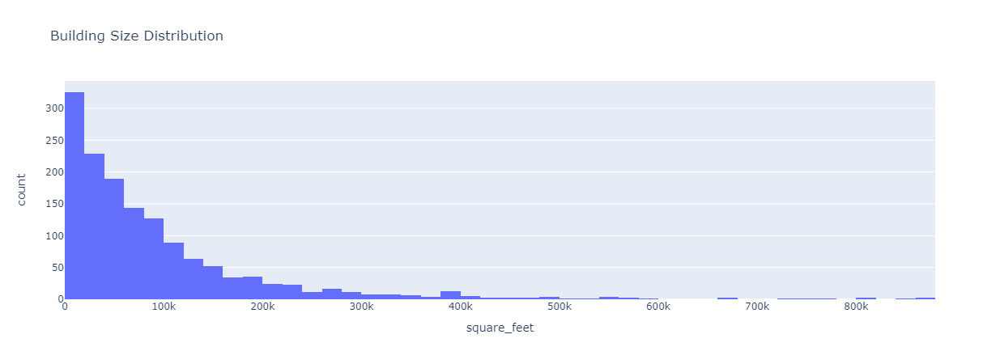

In [22]:
### Distribution of building sizes
fig = px.histogram(data_map['Building Metadata']['df'], x="square_feet",nbins=50,title='Building Size Distribution')
plt.offline.plot(fig, filename=data_map['Building Metadata']['viz_output_folder']  + 'Building Square Feet Distributions.html')
fig.write_image('.//images//'+ 'Building Square Feet Distributions.png')
fig

## Visualization of Sites Colored by ID

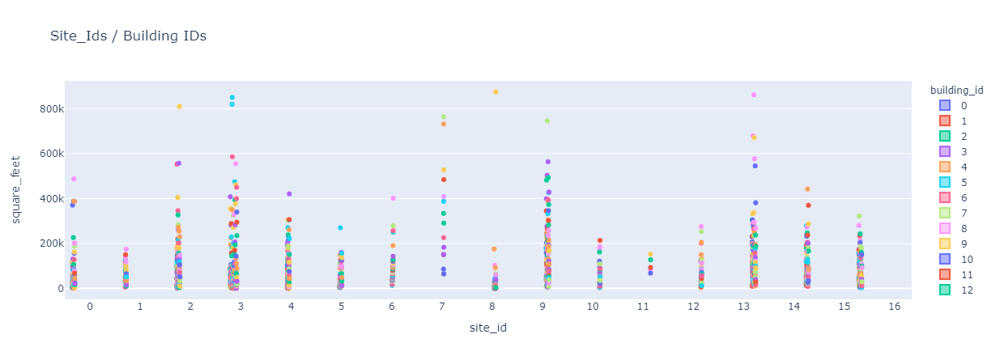

In [23]:
# Boxplot of Sites colored by ID
fig = px.box(data_map['Building Metadata']['df'], x="site_id",y='square_feet',points='all',color='building_id',title='Site_Ids / Building IDs')
fig.update_xaxes(tick0=0, dtick=1)
plt.offline.plot(fig, filename=data_map['Building Metadata']['viz_output_folder']  + 'Box Building Square Feet.html')
fig.write_image('.//images//'+ 'Box Building Square Feet.png')
fig

## Dataframes to Pickles

In [24]:
data_map['Building Metadata']['df'].to_pickle('.//dataframes//Building_Metadata.pkl')

# Train

In [25]:
data_map['Train']['df'].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20216100 entries, 0 to 20216099
Data columns (total 4 columns):
 #   Column         Dtype         
---  ------         -----         
 0   building_id    int64         
 1   meter          int64         
 2   timestamp      datetime64[ns]
 3   meter_reading  float64       
dtypes: datetime64[ns](1), float64(1), int64(2)
memory usage: 616.9 MB


In [26]:
data_map['Train']['df'].groupby('building_id').count()

,meter,timestamp,meter_reading
building_id,,,
0,8784,8784,8784
1,8784,8784,8784
2,8784,8784,8784
3,8784,8784,8784
4,8784,8784,8784
...,...,...,...
1444,7445,7445,7445
1445,7449,7449,7449
1446,7472,7472,7472


In [27]:
data_map['Train']['df']['timestamp'].min()

Timestamp('2016-01-01 00:00:00')

In [28]:
data_map['Train']['df']['timestamp'].max()

Timestamp('2016-12-31 23:00:00')

In [29]:
data_map['Train']['df'].groupby(['meter']).count()

,building_id,timestamp,meter_reading
meter,,,
0,12060910,12060910,12060910
1,4182440,4182440,4182440
2,2708713,2708713,2708713
3,1264037,1264037,1264037


In [30]:
data_map['Train']['df']['timestamp'].value_counts()

2016-12-27 22:00:00    2370
2016-12-27 17:00:00    2369
2016-12-27 21:00:00    2369
2016-12-27 19:00:00    2369
2016-12-27 20:00:00    2369
                       ... 
2016-02-26 01:00:00    1887
2016-02-23 09:00:00    1871
2016-03-23 16:00:00    1822
2016-03-13 03:00:00    1767
2016-03-13 02:00:00    1557
Name: timestamp, Length: 8784, dtype: int64

In [31]:
### Create month

In [32]:
# data_map['Train']['df']['timestamp']

data_map['Train']['df']['season'] = get_season(data_map['Train']['df']['timestamp'])

In [33]:
data_map['Train']['df']['season'].value_counts()

3    5149524
4    5130824
2    5005183
1    4930569
Name: season, dtype: int64

In [38]:
data_map['Train']['df']

,building_id,meter,timestamp,meter_reading,season
0,0,0,2016-01-01 00:00:00,0.000,1
1,1,0,2016-01-01 00:00:00,0.000,1
2,2,0,2016-01-01 00:00:00,0.000,1
3,3,0,2016-01-01 00:00:00,0.000,1
4,4,0,2016-01-01 00:00:00,0.000,1
...,...,...,...,...,...
20216095,1444,0,2016-12-31 23:00:00,8.750,1
20216096,1445,0,2016-12-31 23:00:00,4.825,1
20216097,1446,0,2016-12-31 23:00:00,0.000,1
20216098,1447,0,2016-12-31 23:00:00,159.575,1


In [ ]:
data_map['Train']['df']

Weather Train and Train have same timestamps!!

return### Building meter reading vs Air Temp

## Join Building Meter Data to Weather Data
All buildings joined in case we need to choose another

In [39]:
pd.set_option('mode.chained_assignment',None)

In [40]:
# Goal is to join the weather data to the training data based on what the site id is.
# Weather has site ids, building metadata has site id and building id, and train is just by site ide
# In addtion, we create dataframes of each site id based on

# for random samples in case we randomly pick buildings
from random import sample

# Get the weather training data
weather = data_map['Weather Train']['df']
# Get the training data for the building
train = data_map['Train']['df']
# Get the fact table that references building to site_ID (which is part of)
df_buildings = data_map['Building Metadata']['df']

#Dict that will become dictionary of buidling id and meter type.  Some will have more than one building
building_dict = {}
# Get that building dict and put blank in Train df_splits loatio
data_map['Train']['df_splits'] = building_dict

# Get a sample of building Ids
#sample_building_ids = list(df_buildings['building_id'].sample(n=1, random_state=None))
sample_building_ids = list(df_buildings['building_id'].unique())

# TODO further refine by sections of building ids
max_power = []
b_id = []
met = []
s_ft = []
s_ft_bins = []
fact_dict = {}

# Iterate for every unique building ID
for building_id in sample_building_ids:
    temp_dict = {} # This will be merged data for each building id
    merge_df = merge_weather_to_site(df_buildings, weather, train, building_id) # Merge weather data on a single site's 
    
    squ_ft = float(df_buildings[df_buildings['building_id'] == building_id]['square_feet'].values[0])
    meters = list(merge_df['meter'].unique())
    meter_total = pd.Series(np.zeros(merge_df.shape[0]))
    bld_size = df_buildings[df_buildings['building_id'] == building_id]['square_feet_bins'].values[0]

       

#     meter_df = pd.DataFrame(index=merge_df[merge_df['meter'] == 0].index)        
    # Get the meter readings
    for meter in meters:
        b_id.append(building_id)
        met.append(meter)
        sample_df = merge_df[merge_df['meter'] == meter] 
        # Convert all to kWH
        if meter == 0:
            # Convert to kWH
            sample_df.loc[:,'meter_reading_kWH'] = sample_df['meter_reading'].map(convert_kBTU_to_kWH)
#             temp_meter.index = sample_df.index
#             meter_df.loc[:,'m_0'] = temp_meter
        elif meter in [1,2,3]:
#             temp_meter.index = sample_df.index
#             meter_df.loc[:,'m_' + str(meter)] = sample_df['meter_reading']
            sample_df.loc[:,'meter_reading_kWH'] = sample_df['meter_reading']
        else:
            pass
        max_power.append(max(sample_df.loc[:,'meter_reading_kWH']))
        s_ft.append(squ_ft)
        s_ft_bins.append(bld_size)
        # Sum all meter types in a loop
        temp_dict[meter] = sample_df

    building_dict[building_id] = temp_dict
    data_map['Train']['df_splits'].update(building_dict)

fact_dict['building_id'] = b_id
fact_dict['meter'] = met
fact_dict['squ_ft'] = s_ft
fact_dict['max_power'] = max_power
fact_dict['bld_size'] = s_ft_bins

df_fact = pd.DataFrame(fact_dict)


In [41]:
data_map['Train']['df_splits'][100][0]

,building_id,meter,meter_reading,season,site_id,air_temperature,cloud_coverage,dew_temperature,precip_depth_1_hr,sea_level_pressure,wind_direction,wind_speed,month,meter_reading_kWH
timestamp,,,,,,,,,,,,,,
2016-01-01 00:00:00,100,0,0.000,1,0,25.0,6.0,20.0,NaN,1019.7,0.0,0.0,1,0.000000
2016-01-01 01:00:00,100,0,0.000,1,0,24.4,NaN,21.1,-1.0,1020.2,70.0,1.5,1,0.000000
2016-01-01 02:00:00,100,0,0.000,1,0,22.8,2.0,21.1,0.0,1020.2,0.0,0.0,1,0.000000
2016-01-01 03:00:00,100,0,0.000,1,0,21.1,2.0,20.6,0.0,1020.1,0.0,0.0,1,0.000000
2016-01-01 04:00:00,100,0,0.000,1,0,20.0,2.0,20.0,-1.0,1020.0,250.0,2.6,1,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2016-12-31 19:00:00,100,0,186.202,1,0,22.8,NaN,10.0,0.0,1021.7,140.0,5.7,12,54.572685
2016-12-31 20:00:00,100,0,195.485,1,0,23.3,NaN,8.9,0.0,1021.0,170.0,4.1,12,57.293376
2016-12-31 21:00:00,100,0,188.933,1,0,23.3,NaN,10.0,0.0,1021.1,150.0,4.1,12,55.373095


In [45]:
sample = data_map['Train']['df_splits'][100][0]

In [44]:
sample = sample.resample('1W').agg({'meter_reading':'sum'})

AttributeError: 'function' object has no attribute 'resample'

## Resample, Eliminate missing values from key columns
Resample readings in loop

In [65]:
# Iteration over nested 
l_rows = []

resample_string = '1D' # 
dropna_subset = ['meter_reading','air_temperature']

get_max = lambda x: x.value_counts(dropna=False).index[0]

# Map of how we aggregate new data when it is resampled
agg_dict={'meter_reading':'sum', 
          'air_temperature':'max',
          'dew_temperature':'max',
          'cloud_coverage':'mean',
          'dew_temperature':'max',
          'precip_depth_1_hr':'sum',
          'sea_level_pressure':'mean',
          'meter_reading_kWH':'sum',
          'season':'max'}


scale_cols = ['meter_reading', 
              'air_temperature',
              'dew_temperature',
              'cloud_coverage',
              'dew_temperature',
              'precip_depth_1_hr',
              'sea_level_pressure']

# Iterate over the dictionaries of 
for outer,out_value in data_map['Train']['df_splits'].items():
    for inner, in_value in out_value.items():
        if not outer % 100:
            print('building_id: ' + str(outer) + ' meter: ' + str(inner))
#         print('Before Shape: ' + str(in_value.shape))
        l_rows.append(in_value.shape[0])
      
        sample = in_value
        
        # Resample and aggregate
        sample = sample.resample(resample_string).agg(agg_dict)
       
        # Drop NAs
        #sample.dropna(axis=0, how='any',subset=['meter_reading','air_temperature','cloud_coverage','precip_depth_1_hr','meter_reading_kWH'],inplace=True)
       
        # Remove Zeros
        sample = sample[sample['meter_reading'] != 0]

        data_map['Train']['df_splits'][outer][inner] = sample

#         sample[scale_cols] = pd.DataFrame(scale.fit_transform(df[["A","B"]].values), columns=["A","B"], index=df.index)
#         sample[scale_cols] = pd.DataFrame(scale.fit_transform(df[["A","B"]].values), columns=["A","B"], index=df.index)
   
#         print('After Shape: ' + str(sample.shape))
#        sample.plot()

        df = data_map['Train']['df_splits'][outer][inner]
    

        # df_cols = df.columns
        # df_scale = scale(df)
        # df_scale = pd.DataFrame(df_scale, columns=df_cols)
        # df_scale.head()
#         corrMatrix = df.corr()
#         sns_plot = sns.heatmap(corrMatrix, annot=True)
#         fig = sns_plot.get_figure()
#         fig.savefig('.//images//'+ 'CorrMatrix_Bldg_'+ str(outer) + '_' + str(inner) + '.png')

rows = pd.Series(l_rows)


building_id: 0 meter: 0
building_id: 100 meter: 0
building_id: 200 meter: 0
building_id: 200 meter: 1
building_id: 200 meter: 3
building_id: 300 meter: 0
building_id: 400 meter: 0
building_id: 500 meter: 0
building_id: 600 meter: 0
building_id: 700 meter: 0
building_id: 800 meter: 0
building_id: 800 meter: 1
building_id: 800 meter: 2
building_id: 900 meter: 0
building_id: 900 meter: 1
building_id: 900 meter: 2
building_id: 1000 meter: 0
building_id: 1000 meter: 1
building_id: 1000 meter: 3
building_id: 1100 meter: 0
building_id: 1100 meter: 2
building_id: 1200 meter: 0
building_id: 1200 meter: 2
building_id: 1300 meter: 0
building_id: 1300 meter: 1
building_id: 1300 meter: 3
building_id: 1400 meter: 0
building_id: 1400 meter: 1


In [1]:
data_map['Train']['df_splits'][1297][0]

NameError: name 'data_map' is not defined

In [66]:
data_map['Train']['df_splits'][1297][0]

,meter_reading,air_temperature,dew_temperature,cloud_coverage,precip_depth_1_hr,sea_level_pressure,meter_reading_kWH,season
timestamp,,,,,,,,
2016-01-01,824.4585,5.6,-0.6,1.250000,0.0,1017.747826,241.634965,1
2016-01-02,850.5000,5.0,-6.1,0.947368,0.0,1017.529167,249.267292,1
2016-01-03,844.3781,8.3,-3.3,0.000000,-1.0,1012.154167,247.473066,1
2016-01-04,937.7612,2.8,-4.4,0.363636,0.0,1015.133333,274.842087,1
2016-01-05,989.7522,-1.1,-17.8,0.000000,0.0,1032.112500,290.079777,1
...,...,...,...,...,...,...,...,...
2016-12-27,944.7970,16.7,11.7,2.571429,-2.0,1014.337500,276.904162,1
2016-12-28,969.1019,11.7,-0.6,0.666667,0.0,1016.670833,284.027521,1
2016-12-29,986.6456,5.6,5.0,0.000000,58.0,1012.034783,289.169285,1


## Get Sample Buildings
Get candidate buildings...1 in each category that has

In [44]:
# Summary of sizes
data_map['Building Metadata']['df']['square_feet_bins'].value_counts()

S      655
M      359
L      327
XL      83
XXL     25
Name: square_feet_bins, dtype: int64

## Find the best Building choices, max of each classification of size and has the most meters

### Small

In [45]:
bld_id_list = []

In [46]:
# Want to find the largest in this set that has the most meter readings
sample = data_map['Building Metadata']['df']
sample = sample[sample['square_feet_bins'] == 'S']
sample.sort_values('square_feet',ascending=False,inplace=True)

max_num=-1
target_bld_id = -1

for index, row in sample.iterrows():
    row_bld_id = row['building_id']
    num_meters = len(data_map['Train']['df_splits'][row_bld_id].keys())
    if num_meters > max_num:
        max_num = num_meters
        target_bld_id = row_bld_id
    else:
        pass
        
print('Target Small Building is: ' + str(target_bld_id))

bld_S_meta = sample[sample['building_id'] == target_bld_id]
        
# bld_id = sample_S.iloc[0]['building_id']
# data_map['Train']['df_splits'][bld_

train_S = data_map['Train']['df_splits'][target_bld_id]
print('There are ' + str(len(train_S.keys())) + ' meters available.')
bld_id_list.append(target_bld_id)

Target Small Building is: 1297
There are 4 meters available.


### Medium

In [47]:
# Want to find the largest in this set that has the most meter readings
sample = data_map['Building Metadata']['df']
sample = sample[sample['square_feet_bins'] == 'M']
sample.sort_values('square_feet',ascending=False,inplace=True)

max_num=-1
target_bld_id = -1

for index, row in sample.iterrows():
    row_bld_id = row['building_id']
    num_meters = len(data_map['Train']['df_splits'][row_bld_id].keys())
    if num_meters > max_num:
        max_num = num_meters
        target_bld_id = row_bld_id
    else:
        pass
        
print('Target Medium Building is: ' + str(target_bld_id))

bld_M_meta = sample[sample['building_id'] == target_bld_id]
        
# bld_id = sample_S.iloc[0]['building_id']
# data_map['Train']['df_splits'][bld_

train_M = data_map['Train']['df_splits'][target_bld_id]
print('There are ' + str(len(train_M.keys())) + ' meters available.')
bld_id_list.append(target_bld_id)

Target Medium Building is: 1259
There are 4 meters available.


### Large

In [48]:
# Want to find the largest in this set that has the most meter readings
sample = data_map['Building Metadata']['df']
sample = sample[sample['square_feet_bins'] == 'L']
sample.sort_values('square_feet',ascending=False,inplace=True)

max_num=-1
target_bld_id = -1

for index, row in sample.iterrows():
    row_bld_id = row['building_id']
    num_meters = len(data_map['Train']['df_splits'][row_bld_id].keys())
    if num_meters > max_num:
        max_num = num_meters
        target_bld_id = row_bld_id
    else:
        pass
        
print('Target Medium Building is: ' + str(target_bld_id))

bld_L_meta = sample[sample['building_id'] == target_bld_id]
        
# bld_id = sample_S.iloc[0]['building_id']
# data_map['Train']['df_splits'][bld_

train_L = data_map['Train']['df_splits'][target_bld_id]
print('There are ' + str(len(train_L.keys())) + ' meters available.')
bld_id_list.append(target_bld_id)

Target Medium Building is: 1241
There are 4 meters available.


### XL

In [49]:
# Want to find the largest in this set that has the most meter readings
sample = data_map['Building Metadata']['df']
sample = sample[sample['square_feet_bins'] == 'XL']
sample.sort_values('square_feet',ascending=False,inplace=True)

max_num=-1
target_bld_id = -1

for index, row in sample.iterrows():
    row_bld_id = row['building_id']
    num_meters = len(data_map['Train']['df_splits'][row_bld_id].keys())
    if num_meters > max_num:
        max_num = num_meters
        target_bld_id = row_bld_id
    else:
        pass
        
print('Target Medium Building is: ' + str(target_bld_id))

bld_XL_meta = sample[sample['building_id'] == target_bld_id]
        
# bld_id = sample_S.iloc[0]['building_id']
# data_map['Train']['df_splits'][bld_

train_XL = data_map['Train']['df_splits'][target_bld_id]
print('There are ' + str(len(train_XL.keys())) + ' meters available.')
bld_id_list.append(target_bld_id)

Target Medium Building is: 1258
There are 4 meters available.


### XXL

In [50]:
# Want to find the largest in this set that has the most meter readings
sample = data_map['Building Metadata']['df']
sample = sample[sample['square_feet_bins'] == 'XXL']
sample.sort_values('square_feet',ascending=False,inplace=True)

max_num=-1
target_bld_id = -1

for index, row in sample.iterrows():
    row_bld_id = row['building_id']
    num_meters = len(data_map['Train']['df_splits'][row_bld_id].keys())
    if num_meters > max_num:
        max_num = num_meters
        target_bld_id = row_bld_id
    else:
        pass
        
print('Target Medium Building is: ' + str(target_bld_id))

bld_XXL_meta = sample[sample['building_id'] == target_bld_id]
        
# bld_id = sample_S.iloc[0]['building_id']
# data_map['Train']['df_splits'][bld_

train_XXL = data_map['Train']['df_splits'][target_bld_id]
print('There are ' + str(len(train_XXL.keys())) + ' meters available.')
bld_id_list.append(target_bld_id)

Target Medium Building is: 1148
There are 3 meters available.


## Write these to Pickle

In [51]:
for bld in bld_id_list:
    for inner, in_value in data_map['Train']['df_splits'][bld].items():
        in_value.to_pickle('.//dataframes//Train//Train_bld_' + str(bld) + '_meter_' + str(inner) + '.pkl')

##  Visualization - Build Matrix

### Write Matrix Plots

1297 0
1297 1
1297 2
1297 3
1259 0
1259 1
1259 2
1259 3
1241 0
1241 1
1241 2
1241 3
1258 0
1258 1
1258 2
1258 3
1148 0
1148 1
1148 2


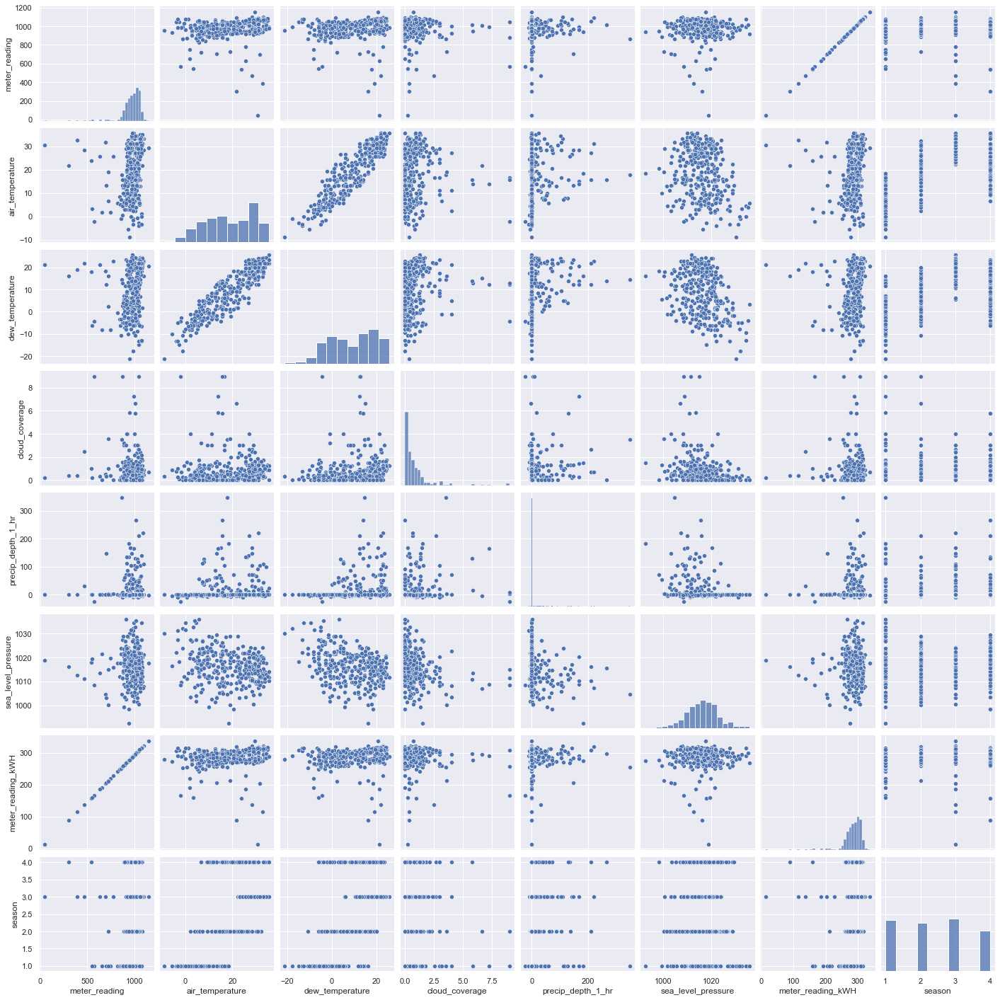

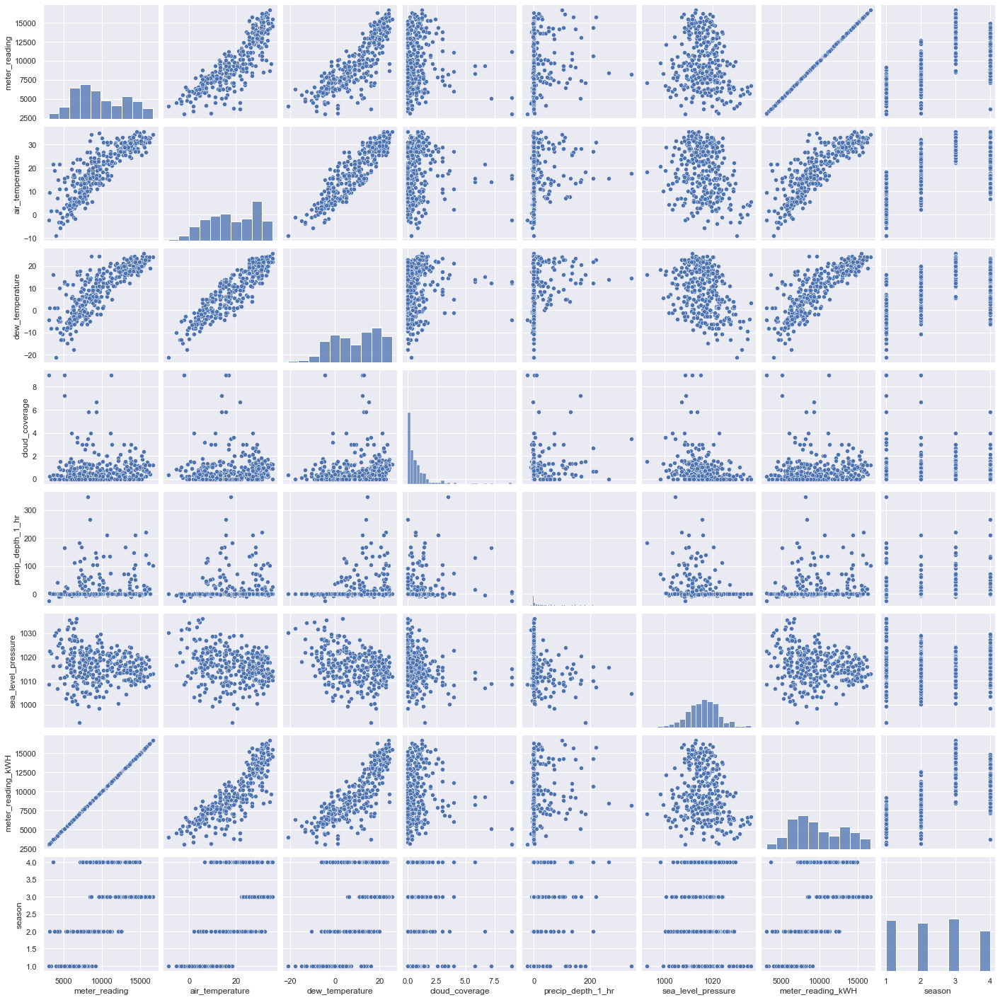

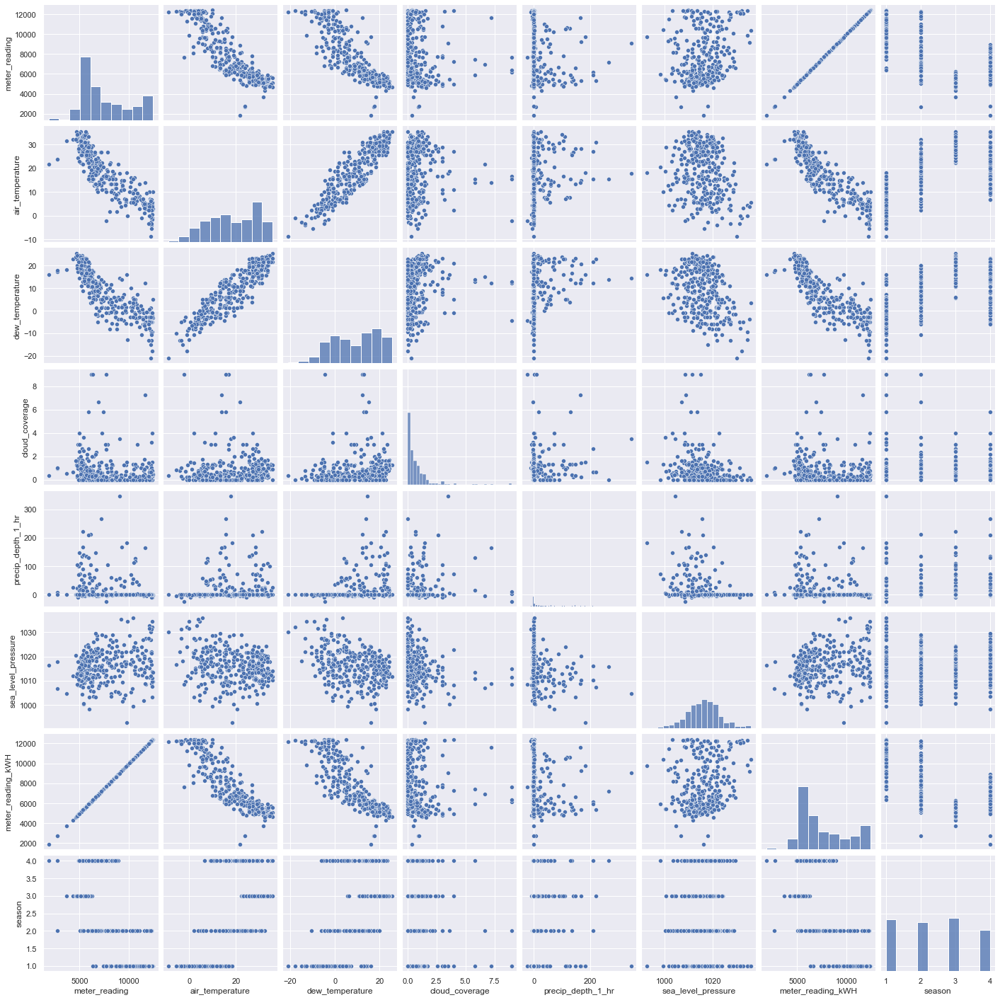

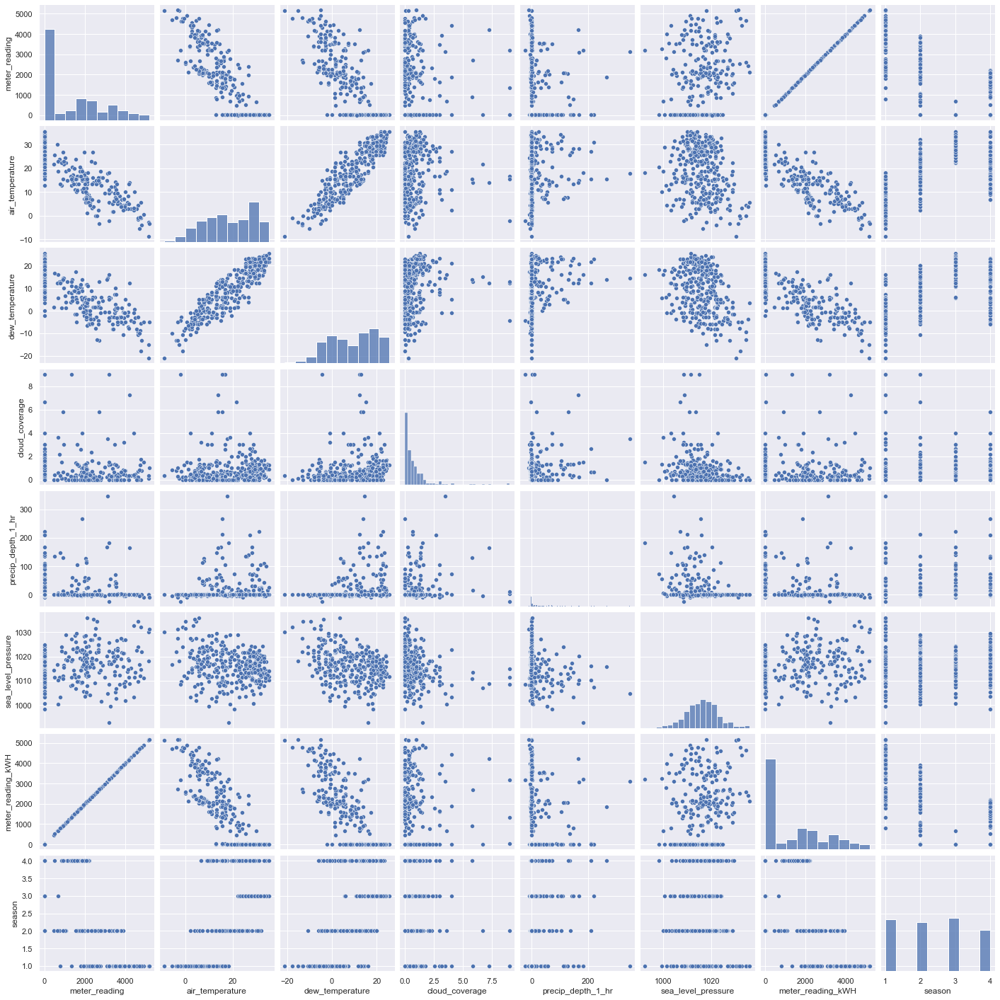

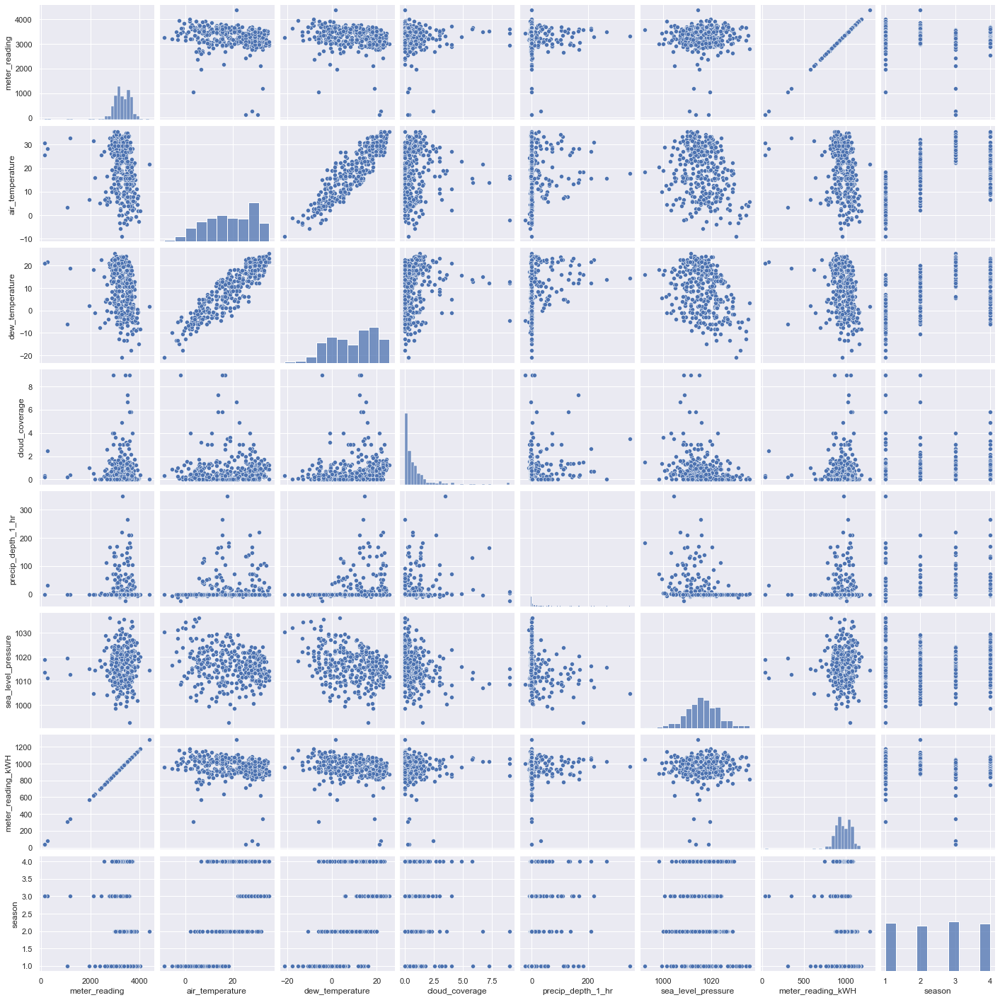

...

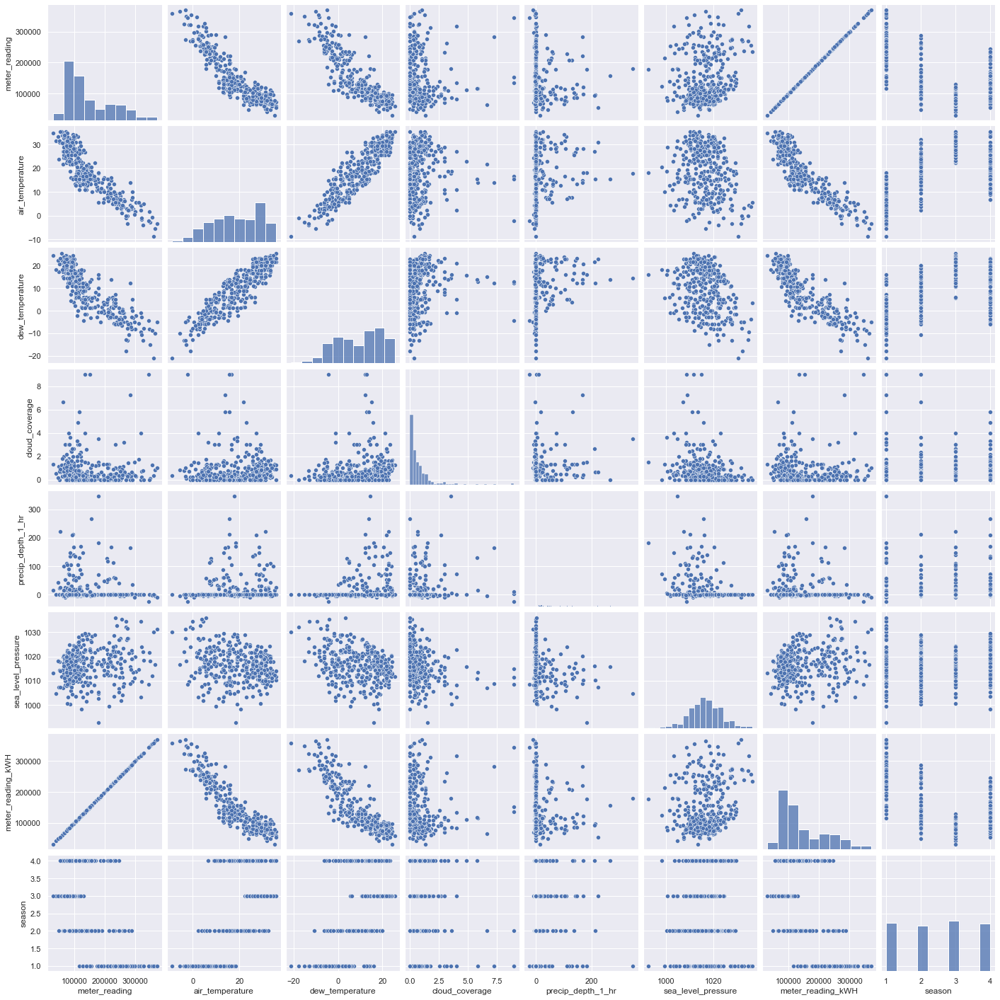

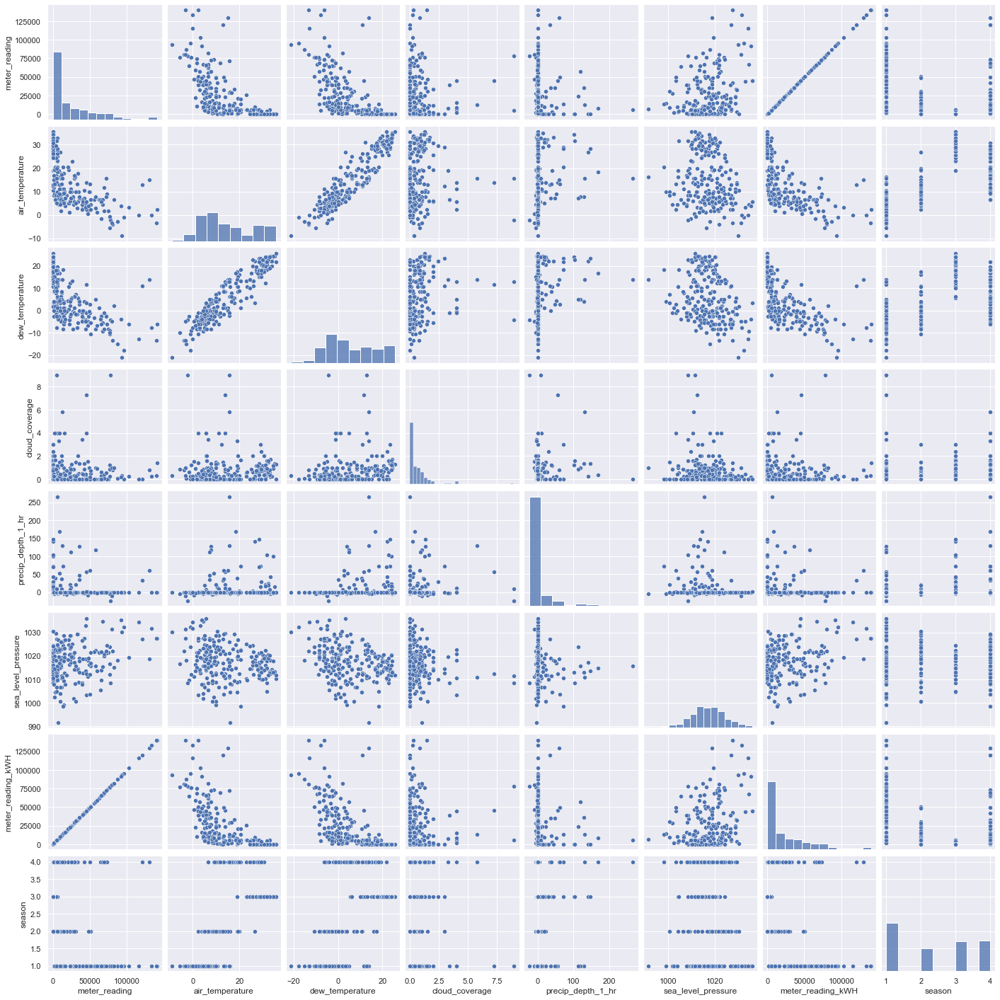

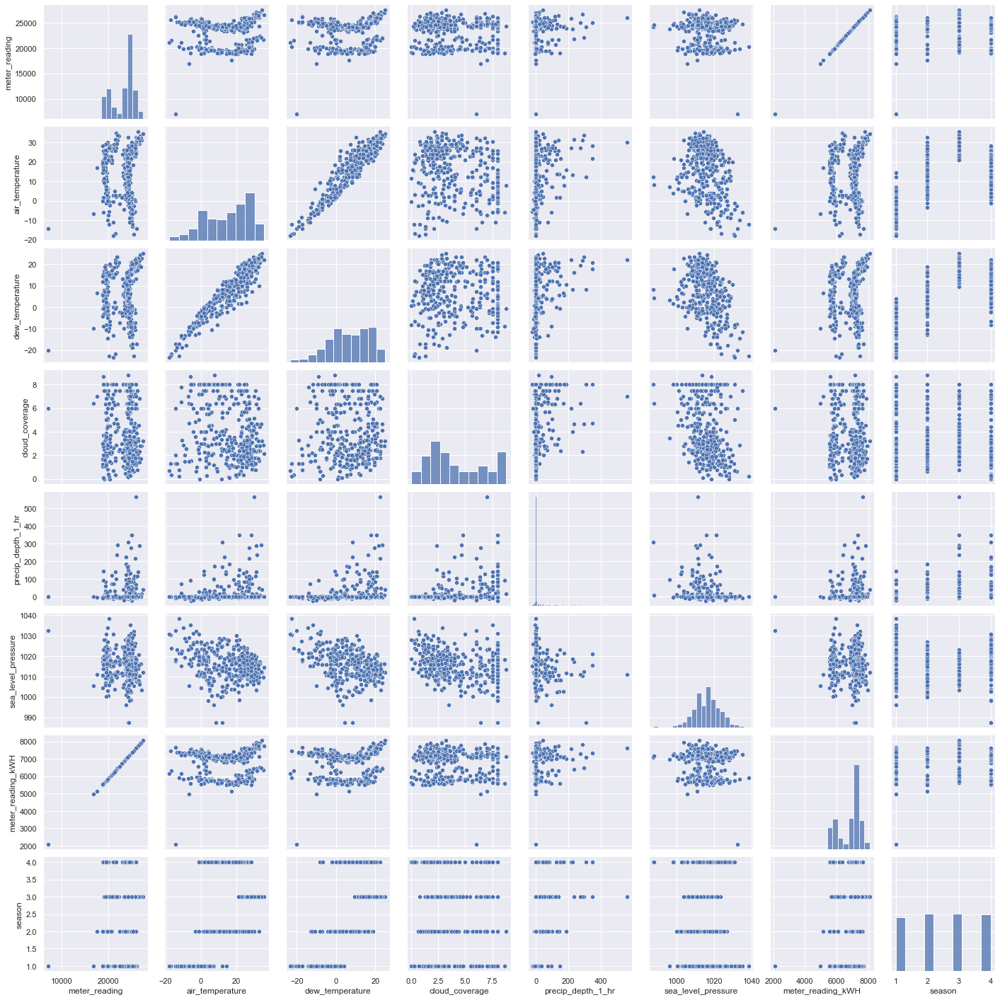

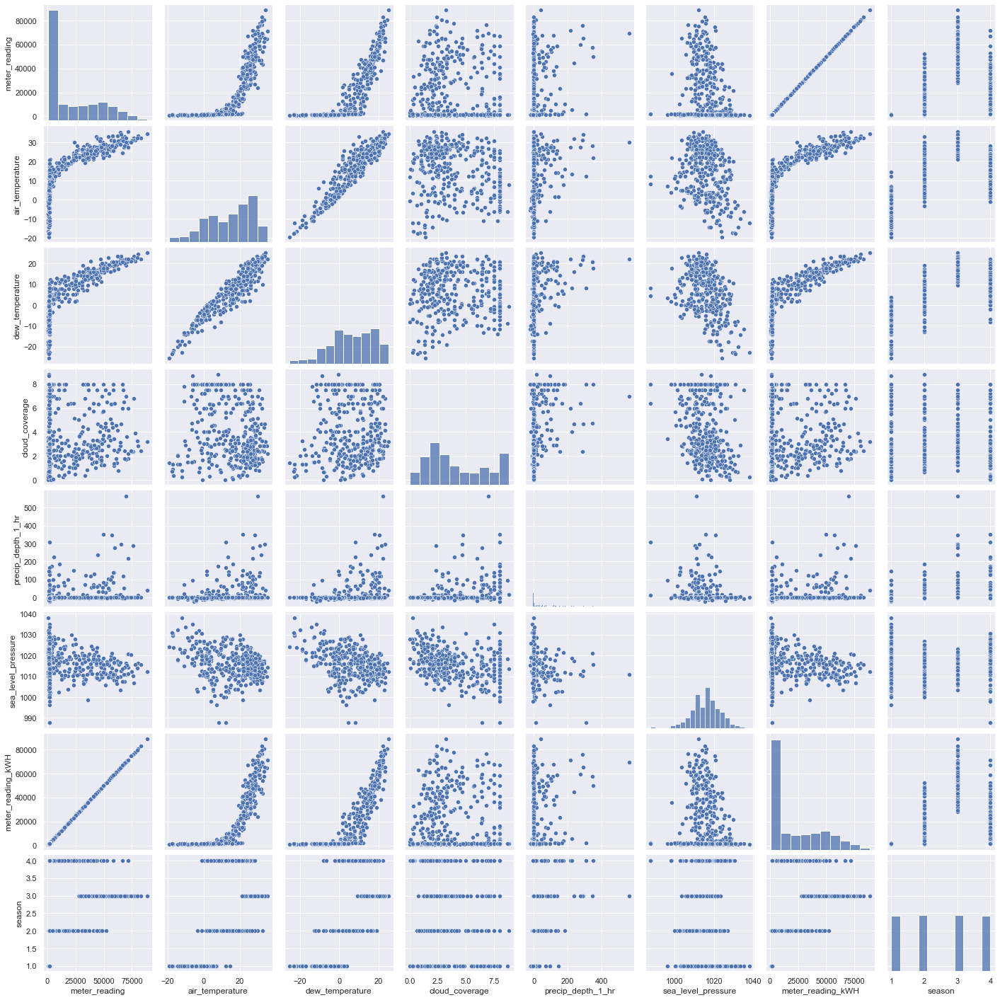

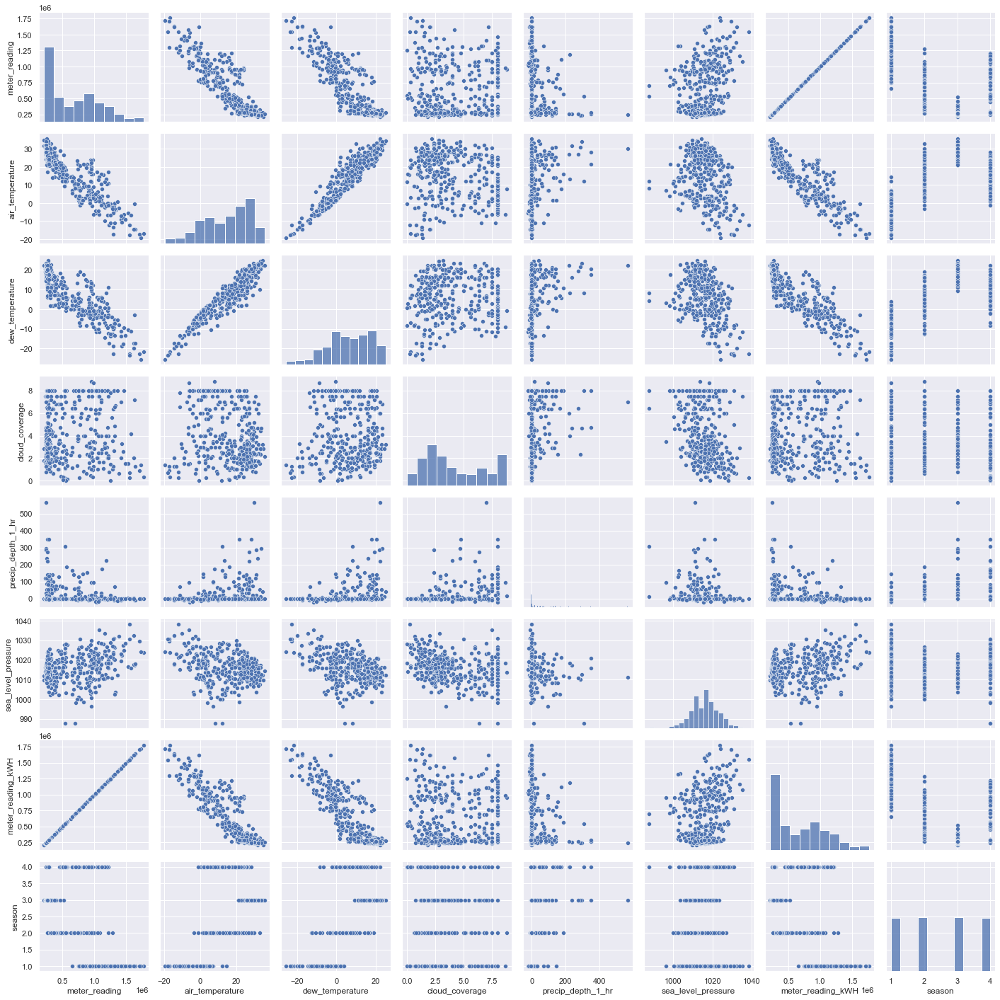

In [53]:
#Step through and make matrix plots
for bld in bld_id_list:
    for inner, in_value in data_map['Train']['df_splits'][bld].items():
        print(bld,inner)
        plt = sns.pairplot(in_value)
        plt.savefig('.//images//' + 'Matrix_' + str(bld) + '_' + str(inner) + '.png')

### Write Pickles of selected Building_ids

In [84]:
#Step through and make matrix plots
for bld in bld_id_list:
    for inner, in_value in data_map['Train']['df_splits'][bld].items():
        print(bld,inner)
        in_value.to_pickle('.//dataframes//Train//Train_bld_' + str(bld) + '_meter_' + str(inner) + '.pkl')

1297 0
1297 1
1297 2
1297 3
1259 0
1259 1
1259 2
1259 3
1241 0
1241 1
1241 2
1241 3
1258 0
1258 1
1258 2
1258 3
1148 0
1148 1
1148 2


In [90]:
pwd

'C:\\Users\\Mike\\Google Drive\\Code\\SpringboardCapstoneOne\\SpringboardCapstoneOne'

In [103]:
for bld in bld_id_list:
    for inner, in_value in data_map['Train']['df_splits'][bld].items():
        report = ppf.ProfileReport(in_value, title=str(bld) + '_' + str(inner),dark_mode=True,explorative=True)
        report_filename = './/reports//' + str(bld) + '_' + str(inner) + '_profile.html'
        report.to_file(report_filename)

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [88]:
# for bld in bld_id_list:
#     for inner, in_value in data_map['Train']['df_splits'][bld].items():


Summarize dataset:   0%|          | 0/23 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

### Summary of Building Types
Show the buildings we picked

In [63]:
sample = data_map['Building Metadata']['df']
sample.loc[sample['building_id'].isin(bld_id_list)].sort_values('square_feet')

,site_id,building_id,primary_use,square_feet,year_built,floor_count,square_feet_bins
1297,14,1297,Office,21469,NaN,NaN,S
1259,14,1259,Education,71088,NaN,NaN,M
1241,14,1241,Healthcare,194188,NaN,NaN,L
1258,14,1258,Education,273234,NaN,NaN,XL
1148,13,1148,Office,861524,NaN,NaN,XXL


In [64]:
# # Step through each split, resample, drop zeros
# for key, value in df_split.items():
#     for key2,value2 in value.items():
#         print('Bldg id: ',str(key))
#         print('Meter: ',str(key2))
#         sample = df_split[key][key2]
#         print('Before: ', str(sample.shape))
#         sample = sample.resample(sample_string).agg(agg_dict)
#         df_split[key][key2] = sample
#         print('Before: ', str(sample.shape))
#         return df_split

In [65]:
sample = data_map['Train']['df_splits'][1148][0]
# mon = sample[sample.index.dayofweek == 1]
# tues = sample[sample.index.dayofweek == 2]
# wed = sample[sample.index.dayofweek == 3]
# thur = sample[sample.index.dayofweek == 4]
# fri = sample[sample.index.dayofweek == 5]
# sat = sample[sample.index.dayofweek == 1]
# sun = sample[sample.index.dayofweek == 0]
sample

,meter_reading,air_temperature,dew_temperature,cloud_coverage,precip_depth_1_hr,sea_level_pressure,meter_reading_kWH,season
timestamp,,,,,,,,
2016-01-01,20177.558,-1.1,-7.8,2.666667,-5.0,1020.216667,5913.703986,1.0
2016-01-02,20335.314,-0.6,-8.3,0.000000,0.0,1018.445833,5959.939625,1.0
2016-01-03,20330.554,-2.2,-6.7,3.111111,0.0,1022.939130,5958.544549,1.0
2016-01-04,25479.110,-2.8,-7.8,0.666667,0.0,1031.887500,7467.500000,1.0
2016-01-05,25867.214,0.0,-7.2,4.000000,0.0,1026.226087,7581.246776,1.0
...,...,...,...,...,...,...,...,...
2016-12-27,23361.222,-4.4,-10.0,4.000000,-17.0,1019.008333,6846.782532,1.0
2016-12-28,23139.357,2.2,-3.9,2.250000,0.0,1010.662500,6781.757620,1.0
2016-12-29,22919.832,1.7,-2.8,3.000000,-4.0,1011.616667,6717.418523,1.0


<AxesSubplot:xlabel='season', ylabel='meter_reading'>

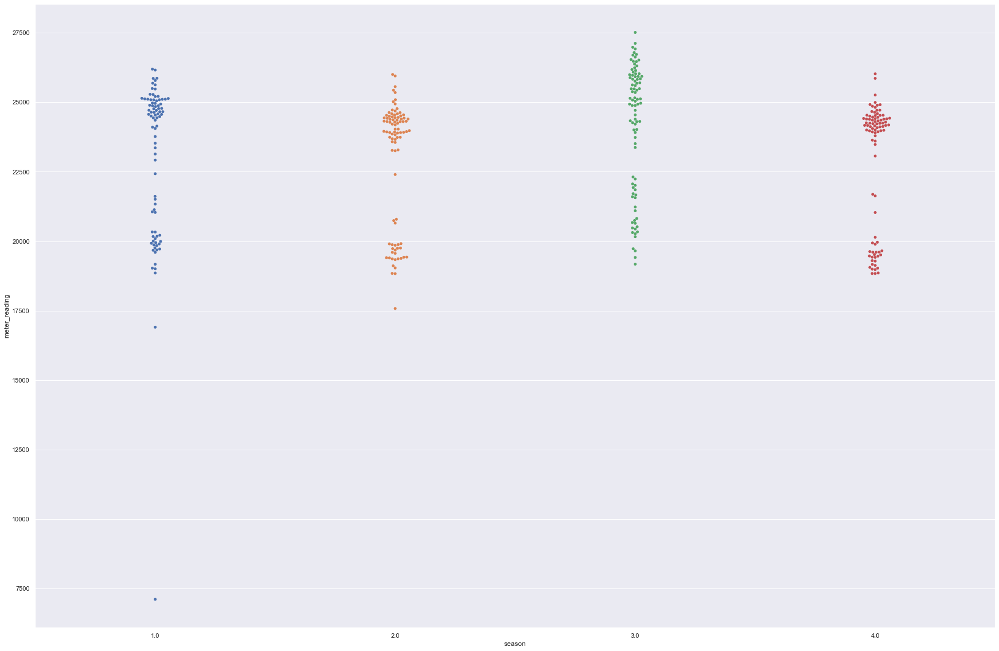

In [66]:
sns.swarmplot(data=sample,x='season',y='meter_reading')

In [81]:
data_map['Train']['df_splits'][1297][0]

,meter_reading,air_temperature,dew_temperature,cloud_coverage,precip_depth_1_hr,sea_level_pressure,meter_reading_kWH,season
timestamp,,,,,,,,
2016-01-01,824.4585,5.6,-0.6,1.250000,0.0,1017.747826,241.634965,1
2016-01-02,850.5000,5.0,-6.1,0.947368,0.0,1017.529167,249.267292,1
2016-01-03,844.3781,8.3,-3.3,0.000000,-1.0,1012.154167,247.473066,1
2016-01-04,937.7612,2.8,-4.4,0.363636,0.0,1015.133333,274.842087,1
2016-01-05,989.7522,-1.1,-17.8,0.000000,0.0,1032.112500,290.079777,1
...,...,...,...,...,...,...,...,...
2016-12-27,944.7970,16.7,11.7,2.571429,-2.0,1014.337500,276.904162,1
2016-12-28,969.1019,11.7,-0.6,0.666667,0.0,1016.670833,284.027521,1
2016-12-29,986.6456,5.6,5.0,0.000000,58.0,1012.034783,289.169285,1


## Test

In [ ]:
data_map['Test']['df'].info()

In [ ]:
data_map['Test']['df'].head()

In [ ]:
data_map['Test']['df'].groupby('building_id').count()

In [ ]:
data_map['Test']['df'].head()

In [ ]:
data_map['Test']['df']['timestamp'].min()

In [ ]:
data_map['Test']['df']['timestamp'].max()

In [ ]:
buildProfiles(data_map)